In [ ]:
import requests

API_KEY = "522ee874f1ad7fda68394ed5805a2f79"

def discover_movie_ids(start_date="2019-01-01", end_date="2023-12-31", pages=5):
    ids = set()
    for page in range(1, pages + 1):
        r = requests.get(
            "https://api.themoviedb.org/3/discover/movie",
            params={
                "api_key": API_KEY,
                "sort_by": "popularity.desc",
                "primary_release_date.gte": start_date,
                "primary_release_date.lte": end_date,
                "include_adult": "false",
                "page": page,
            },
            timeout=30,
        )
        r.raise_for_status()
        for m in r.json().get("results", []):
            ids.add(m["id"])
    return list(ids)


In [ ]:
def fetch_movie_enriched(movie_id: int) -> dict:
    r = requests.get(
        f"https://api.themoviedb.org/3/movie/{movie_id}",
        params={"api_key": API_KEY, "append_to_response": "credits,keywords"},
        timeout=30,
    )
    r.raise_for_status()
    return r.json()


In [ ]:
import json
from tqdm import tqdm

movie_ids = discover_movie_ids(pages=20)  # 25 pages ~ 500 movies

with open("movies_enriched.jsonl", "w", encoding="utf-8") as f:
    for mid in tqdm(movie_ids):
        data = fetch_movie_enriched(mid)
        f.write(json.dumps(data) + "\n")


100%|██████████| 400/400 [00:34<00:00, 11.68it/s]


In [ ]:
import json

movies = []

with open("movies_enriched.jsonl", "r", encoding="utf-8") as f:
    for line in f:
        movies.append(json.loads(line))

len(movies)


400

In [ ]:
movies

[{'adult': False,
  'backdrop_path': '/jqOCty3utHRzDf8BNX5rP6p0UDe.jpg',
  'belongs_to_collection': None,
  'budget': 5000000,
  'genres': [{'id': 14, 'name': 'Fantasy'}, {'id': 18, 'name': 'Drama'}],
  'homepage': '',
  'id': 399363,
  'imdb_id': 'tt2420124',
  'origin_country': ['US'],
  'original_language': 'en',
  'original_title': 'Wendy',
  'overview': 'A re-imagining of "Peter Pan" from the point of view of Wendy Darling, who finds herself lost on a mysterious island where aging and time have come unglued. She must fight to save her family, her freedom and the joyous spirit of youth.',
  'popularity': 7.9028,
  'poster_path': '/nphsStbtAuJ2IaXtCvDXDwMUF5N.jpg',
  'production_companies': [{'id': 127929,
    'logo_path': '/7DLKyL15ETI9645XSr9JcbMV79c.png',
    'name': 'Searchlight Pictures',
    'origin_country': 'US'},
   {'id': 89142,
    'logo_path': '/bfMAgFDoS5niHK077WKdoUMgLHp.png',
    'name': 'Department of Motion Pictures',
    'origin_country': 'US'},
   {'id': 6714,
   

In [ ]:
import requests

API_KEY = "522ee874f1ad7fda68394ed5805a2f79"
BASE_URL = "https://api.themoviedb.org/3"

def discover_movie_ids(start_date="2018-01-01", end_date="2023-12-31", pages=20):
    ids = set()
    for page in range(1, pages + 1):
        r = requests.get(
            f"{BASE_URL}/discover/movie",
            params={
                "api_key": API_KEY,
                "sort_by": "popularity.desc",
                "primary_release_date.gte": start_date,
                "primary_release_date.lte": end_date,
                "include_adult": "false",
                "include_video": "false",
                "page": page,
            },
            timeout=30,
        )
        r.raise_for_status()
        ids.update(m["id"] for m in r.json().get("results", []) if "id" in m)
    return sorted(ids)


In [ ]:
def fetch_movie_with_credits(movie_id: int) -> dict:
    r = requests.get(
        f"{BASE_URL}/movie/{movie_id}",
        params={"api_key": API_KEY, "append_to_response": "credits"},
        timeout=30,
    )
    r.raise_for_status()
    return r.json()


In [ ]:
import pandas as pd
from tqdm import tqdm

def extract_directors(crew: list[dict]) -> list[dict]:
    return [
        {"person_id": p["id"], "name": p["name"]}
        for p in crew
        if p.get("job") == "Director" and "id" in p and "name" in p
    ]

def extract_top_cast(cast: list[dict], top_n: int = 10) -> list[dict]:
    cast_sorted = sorted(cast, key=lambda x: x.get("order", 9999))[:top_n]
    return [
        {
            "person_id": p.get("id"),
            "name": p.get("name"),
            "character": p.get("character"),
            "order": p.get("order"),
        }
        for p in cast_sorted
    ]

def build_movie_dataset(start_date="2018-01-01", end_date="2023-12-31", pages=20, top_cast_n=10) -> pd.DataFrame:
    movie_ids = discover_movie_ids(start_date=start_date, end_date=end_date, pages=pages)

    rows = []
    for mid in tqdm(movie_ids, desc="Fetching movies"):
        m = fetch_movie_with_credits(mid)

        credits = m.get("credits", {})
        crew = credits.get("crew", []) or []
        cast = credits.get("cast", []) or []

        rows.append({
            "movie_id": m.get("id"),
            "title": m.get("title"),
            "release_date": m.get("release_date"),

            # popularity + ratings
            "popularity": m.get("popularity"),
            "vote_average": m.get("vote_average"),
            "vote_count": m.get("vote_count"),

            # people
            "directors": extract_directors(crew),
            "top_cast": extract_top_cast(cast, top_cast_n),
        })

    df = pd.DataFrame(rows)
    return df

df = build_movie_dataset(pages=20, top_cast_n=10)
df.head()


Fetching movies: 100%|██████████| 400/400 [00:38<00:00, 10.50it/s]


,movie_id,title,release_date,popularity,vote_average,vote_count,directors,top_cast
0,76600,Avatar: The Way of Water,2022-12-14,34.3071,7.600,13643,"[{'person_id': 2710, 'name': 'James Cameron'}]","[{'person_id': 65731, 'name': 'Sam Worthington..."
1,166428,How to Train Your Dragon: The Hidden World,2019-01-03,8.5267,7.747,6946,"[{'person_id': 69797, 'name': 'Dean DeBlois'}]","[{'person_id': 449, 'name': 'Jay Baruchel', 'c..."
2,181812,Star Wars: The Rise of Skywalker,2019-12-18,10.1479,6.300,10594,"[{'person_id': 15344, 'name': 'J.J. Abrams'}]","[{'person_id': 4, 'name': 'Carrie Fisher', 'ch..."
3,260513,Incredibles 2,2018-06-14,8.9105,7.453,13481,"[{'person_id': 7087, 'name': 'Brad Bird'}]","[{'person_id': 8977, 'name': 'Craig T. Nelson'..."
4,284054,Black Panther,2018-02-13,13.1717,7.363,23147,"[{'person_id': 1056121, 'name': 'Ryan Coogler'}]","[{'person_id': 172069, 'name': 'Chadwick Bosem..."


In [ ]:
df['top_cast'][0]

[{'person_id': 65731,
  'name': 'Sam Worthington',
  'character': 'Jake Sully',
  'order': 0},
 {'person_id': 8691,
  'name': 'Zoe Saldaña',
  'character': 'Neytiri',
  'order': 1},
 {'person_id': 10205,
  'name': 'Sigourney Weaver',
  'character': 'Kiri',
  'order': 2},
 {'person_id': 32747,
  'name': 'Stephen Lang',
  'character': 'Colonel Miles Quaritch',
  'order': 3},
 {'person_id': 204, 'name': 'Kate Winslet', 'character': 'Ronal', 'order': 4},
 {'person_id': 7248,
  'name': 'Cliff Curtis',
  'character': 'Tonowari',
  'order': 5},
 {'person_id': 59231,
  'name': 'Joel David Moore',
  'character': 'Norm Spellman',
  'order': 6},
 {'person_id': 30485, 'name': 'CCH Pounder', 'character': "Mo'at", 'order': 7},
 {'person_id': 36190,
  'name': 'Edie Falco',
  'character': 'General Frances Ardmore',
  'order': 8},
 {'person_id': 55936,
  'name': 'Jemaine Clement',
  'character': 'Dr. Ian Garvin',
  'order': 9}]

In [ ]:
import requests

API_KEY = "522ee874f1ad7fda68394ed5805a2f79"
BASE_URL = "https://api.themoviedb.org/3"

def fetch_person(person_id: int) -> dict:
    r = requests.get(
        f"{BASE_URL}/person/{person_id}",
        params={"api_key": API_KEY},
        timeout=30,
    )
    r.raise_for_status()
    return r.json()

actor = fetch_person(65731)
actor.keys()
actor

{'adult': False,
 'also_known_as': ['Samuel Henry John "Sam" Worthington',
  'Сем Вортінгтон',
  'סמואל הנרי ג\'ון "סם" וורת\'ינגטון',
  'ซามูเอล เฮนรี จอห์น เวิร์ธธิงตัน',
  'סם וורתינגטון',
  'Samuel Henry John Worthington',
  'Samuel Worthington'],
 'biography': "Samuel Henry John Worthington\xa0(born 2 August 1976) is an Australian actor. He is known for playing\xa0Jake Sully\xa0in the\xa0Avatar\xa0franchise\xa0(2009–present), Marcus Wright in\xa0Terminator Salvation\xa0(2009), and\xa0Perseus\xa0in\xa0Clash of the Titans\xa0(2010) and its sequel\xa0Wrath of the Titans\xa0(2012).\n\nHe has taken other dramatic roles, appearing in\xa0The Debt\xa0(2010),\xa0Everest\xa0(2015),\xa0Hacksaw Ridge (2016),\xa0The Shack\xa0(2017),\xa0Manhunt\xa0(2017), and\xa0Fractured\xa0(2019). He has received\xa0Australia's highest film award\xa0three times for his leading roles in\xa0Bootmen\xa0(2000),\xa0Somersault\xa0(2004), and\xa0Avatar (2009).\n\nOn television, Worthington appeared in Australia as H

In [ ]:
df['directors'][0]

[{'person_id': 2710, 'name': 'James Cameron'}]

In [ ]:
def fetch_person_credits(person_id: int) -> dict:
    r = requests.get(
        f"{BASE_URL}/person/{person_id}/movie_credits",
        params={"api_key": API_KEY},
        timeout=30,
    )
    r.raise_for_status()
    return r.json()


In [ ]:
import json, os

os.makedirs("person_cache", exist_ok=True)

def get_person_cached(person_id: int) -> dict:
    path = f"person_cache/{person_id}.json"
    if os.path.exists(path):
        with open(path, "r", encoding="utf-8") as f:
            return json.load(f)

    data = fetch_person(person_id)
    with open(path, "w", encoding="utf-8") as f:
        json.dump(data, f)

    return data


In [ ]:
def enrich_cast(top_cast: list[dict]) -> list[dict]:
    enriched = []
    for actor in top_cast:
        pid = actor["person_id"]
        person = get_person_cached(pid)

        enriched.append({
            **actor,
            "actor_popularity": person.get("popularity", 0.0),
            "gender": person.get("gender"),
            "known_for_department": person.get("known_for_department"),
        })
    return enriched

df["top_cast_enriched"] = df["top_cast"].apply(enrich_cast)


In [ ]:
import numpy as np

def cast_aggregate_features(cast):
    pops = [a.get("actor_popularity", 0.0) for a in cast]
    return pd.Series({
        "cast_pop_mean": np.mean(pops) if pops else 0.0,
        "cast_pop_max": np.max(pops) if pops else 0.0,
        "n_star_cast": sum(1 for x in pops if x >= 10),
    })

cast_features = df["top_cast_enriched"].apply(cast_aggregate_features)
df = pd.concat([df, cast_features], axis=1)


In [ ]:
df

,movie_id,title,release_date,popularity,vote_average,vote_count,directors,top_cast,top_cast_enriched,cast_pop_mean,cast_pop_max,n_star_cast
0,76600,Avatar: The Way of Water,2022-12-14,34.3071,7.600,13643,"[{'person_id': 2710, 'name': 'James Cameron'}]","[{'person_id': 65731, 'name': 'Sam Worthington...","[{'person_id': 65731, 'name': 'Sam Worthington...",4.088230,7.6548,0.0
1,166428,How to Train Your Dragon: The Hidden World,2019-01-03,8.5267,7.747,6946,"[{'person_id': 69797, 'name': 'Dean DeBlois'}]","[{'person_id': 449, 'name': 'Jay Baruchel', 'c...","[{'person_id': 449, 'name': 'Jay Baruchel', 'c...",3.253990,7.2830,0.0
2,181812,Star Wars: The Rise of Skywalker,2019-12-18,10.1479,6.300,10594,"[{'person_id': 15344, 'name': 'J.J. Abrams'}]","[{'person_id': 4, 'name': 'Carrie Fisher', 'ch...","[{'person_id': 4, 'name': 'Carrie Fisher', 'ch...",2.407810,3.8558,0.0
3,260513,Incredibles 2,2018-06-14,8.9105,7.453,13481,"[{'person_id': 7087, 'name': 'Brad Bird'}]","[{'person_id': 8977, 'name': 'Craig T. Nelson'...","[{'person_id': 8977, 'name': 'Craig T. Nelson'...",2.535700,7.2637,0.0
4,284054,Black Panther,2018-02-13,13.1717,7.363,23147,"[{'person_id': 1056121, 'name': 'Ryan Coogler'}]","[{'person_id': 172069, 'name': 'Chadwick Bosem...","[{'person_id': 172069, 'name': 'Chadwick Bosem...",3.911740,7.8849,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
395,1259560,Party Levitation,2021-08-02,10.2830,0.000,0,[],"[{'person_id': 236380, 'name': 'Michael Findla...","[{'person_id': 236380, 'name': 'Michael Findla...",2.257660,7.2910,0.0
396,1288484,Lord El-Melloi II Case Files: case. Adra Castl...,2020-07-08,8.8782,9.000,1,[],"[{'person_id': 1201312, 'name': 'Yuya Matsushi...","[{'person_id': 1201312, 'name': 'Yuya Matsushi...",2.433471,5.8837,0.0
397,1296874,The Thing,2018-01-01,9.3143,0.000,0,"[{'person_id': 583857, 'name': 'Peter Strickla...","[{'person_id': 5506313, 'name': 'Cosey Fanny T...","[{'person_id': 5506313, 'name': 'Cosey Fanny T...",0.114600,0.1146,0.0
398,1329050,Knock,2020-01-01,9.1927,0.000,0,"[{'person_id': 1621247, 'name': 'Ricardo Varon...","[{'person_id': 1506477, 'name': 'Juliana Sass'...","[{'person_id': 1506477, 'name': 'Juliana Sass'...",0.164000,0.2068,0.0


In [ ]:
import pandas as pd
import numpy as np

TOP_N = 5

def extract_top_actor_features(cast, top_n=TOP_N):
    row = {}
    for i in range(top_n):
        if i < len(cast):
            actor = cast[i]
            row[f"actor{i+1}_popularity"] = actor.get("actor_popularity", 0.0)
            row[f"actor{i+1}_gender"] = actor.get("gender")
        else:
            row[f"actor{i+1}_popularity"] = 0.0
            row[f"actor{i+1}_gender"] = None
    return pd.Series(row)

actor_features = df["top_cast_enriched"].apply(extract_top_actor_features)
df = pd.concat([df, actor_features], axis=1)


In [ ]:
STAR_THRESHOLD = 5.0  # adjusted for TMDB scale

def compute_cast_aggregates(cast):
    pops = [a.get("actor_popularity", 0.0) for a in cast]
    return pd.Series({
        "cast_pop_mean": np.mean(pops) if pops else 0.0,
        "cast_pop_max": np.max(pops) if pops else 0.0,
        "n_star_cast": sum(1 for p in pops if p >= STAR_THRESHOLD),
    })

cast_agg = df["top_cast_enriched"].apply(compute_cast_aggregates)
df = pd.concat([df, cast_agg], axis=1)


In [ ]:
def enrich_director(directors):
    if not directors:
        return {"director_popularity": 0.0}

    d = directors[0]  # first director
    person = get_person_cached(d["person_id"])

    return {
        "director_popularity": person.get("popularity", 0.0),
        "director_gender": person.get("gender"),
        "director_department": person.get("known_for_department"),
    }


In [ ]:
director_features = df["directors"].apply(enrich_director).apply(pd.Series)
df = pd.concat([df, director_features], axis=1)


In [ ]:
DROP_COLS = [
    "top_cast",
    "top_cast_enriched",
    "cast",
    "crew",
    "directors",
]

df_ml = df.drop(columns=[c for c in DROP_COLS if c in df.columns])


In [ ]:
df_ml.head()
df_ml.shape

(400, 25)

In [ ]:
df_ml

,movie_id,title,release_date,popularity,vote_average,vote_count,cast_pop_mean,cast_pop_max,n_star_cast,actor1_popularity,...,actor4_popularity,actor4_gender,actor5_popularity,actor5_gender,cast_pop_mean,cast_pop_max,n_star_cast,director_popularity,director_gender,director_department
0,76600,Avatar: The Way of Water,2022-12-14,34.3071,7.600,13643,4.088230,7.6548,0.0,4.4647,...,6.5016,2.0,6.6845,1.0,4.088230,7.6548,3.0,4.2572,2.0,Directing
1,166428,How to Train Your Dragon: The Hidden World,2019-01-03,8.5267,7.747,6946,3.253990,7.2830,0.0,1.5776,...,4.5010,1.0,7.2830,2.0,3.253990,7.2830,1.0,0.7771,2.0,Directing
2,181812,Star Wars: The Rise of Skywalker,2019-12-18,10.1479,6.300,10594,2.407810,3.8558,0.0,1.9162,...,2.2518,2.0,1.4274,2.0,2.407810,3.8558,0.0,2.4585,2.0,Directing
3,260513,Incredibles 2,2018-06-14,8.9105,7.453,13481,2.535700,7.2637,0.0,1.6615,...,1.2223,2.0,1.8345,1.0,2.535700,7.2637,1.0,1.4975,2.0,Directing
4,284054,Black Panther,2018-02-13,13.1717,7.363,23147,3.911740,7.8849,0.0,2.9407,...,2.7649,1.0,2.4989,2.0,3.911740,7.8849,3.0,3.0480,2.0,Directing
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,1259560,Party Levitation,2021-08-02,10.2830,0.000,0,2.257660,7.2910,0.0,1.3180,...,2.0660,1.0,7.2910,2.0,2.257660,7.2910,1.0,0.0000,NaN,NaN
396,1288484,Lord El-Melloi II Case Files: case. Adra Castl...,2020-07-08,8.8782,9.000,1,2.433471,5.8837,0.0,5.6378,...,0.0982,0.0,4.4394,1.0,2.433471,5.8837,2.0,0.0000,NaN,NaN
397,1296874,The Thing,2018-01-01,9.3143,0.000,0,0.114600,0.1146,0.0,0.1146,...,0.0000,NaN,0.0000,NaN,0.114600,0.1146,0.0,3.4821,2.0,Directing
398,1329050,Knock,2020-01-01,9.1927,0.000,0,0.164000,0.2068,0.0,0.1212,...,0.0000,NaN,0.0000,NaN,0.164000,0.2068,0.0,0.0610,0.0,Camera


In [ ]:
df_ml.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 25 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   movie_id             400 non-null    int64  
 1   title                400 non-null    object 
 2   release_date         400 non-null    object 
 3   popularity           400 non-null    float64
 4   vote_average         400 non-null    float64
 5   vote_count           400 non-null    int64  
 6   cast_pop_mean        400 non-null    float64
 7   cast_pop_max         400 non-null    float64
 8   n_star_cast          400 non-null    float64
 9   actor1_popularity    400 non-null    float64
 10  actor1_gender        398 non-null    float64
 11  actor2_popularity    400 non-null    float64
 12  actor2_gender        396 non-null    float64
 13  actor3_popularity    400 non-null    float64
 14  actor3_gender        389 non-null    float64
 15  actor4_popularity    400 non-null    flo

In [ ]:
import pandas as pd
import numpy as np

def add_movie_features(
    df: pd.DataFrame,
    *,
    top_languages: int = 10,
    add_language_dummies: bool = True
) -> pd.DataFrame:
    """
    Adds movie-level, pre-release-safe features:
      - release_month, release_year
      - runtime cleaned + is_long_movie
      - keyword_count
      - genre_count
      - genre_* multi-hot columns
      - optional: language_* dummies for top K languages

    Expects columns:
      - release_date (string or datetime)
      - runtime (numeric, may be missing)
      - genres (list[str])
      - keywords (list[str])
      - original_language (optional)
    """
    df = df.copy()

    # 0) Remove duplicate columns if you accidentally created them twice
    df = df.loc[:, ~df.columns.duplicated()]

    # 1) release_date -> month/year (avoid raw date in ML)
    df["release_date"] = pd.to_datetime(df["release_date"], errors="coerce")
    # drop rows with no date (optional; you can also impute)
    df = df.dropna(subset=["release_date"])

    df["release_month"] = df["release_date"].dt.month.astype(int)
    df["release_year"] = df["release_date"].dt.year.astype(int)

    # 2) runtime cleaning
    df["runtime"] = pd.to_numeric(df["runtime"], errors="coerce")
    if df["runtime"].isna().all():
        # fallback if everything missing
        df["runtime"] = 0.0
    else:
        df["runtime"] = df["runtime"].fillna(df["runtime"].median())
    df["is_long_movie"] = (df["runtime"] >= 120).astype(int)

    # 3) keyword_count (safe and simple)
    def _len_list(x):
        return len(x) if isinstance(x, list) else 0

    df["keyword_count"] = df["keywords"].apply(_len_list)

    # 4) genre_count + multi-hot genres
    df["genre_count"] = df["genres"].apply(_len_list)

    # multi-hot encode: explode -> get_dummies -> groupby index
    genres_series = df["genres"].apply(lambda g: g if isinstance(g, list) else []).explode()
    genre_dummies = pd.get_dummies(genres_series)

    # if a movie had no genres, explode() gives NaN row -> drop it before groupby
    genre_dummies = genre_dummies.groupby(level=0).sum()

    # prefix columns to avoid collisions
    genre_dummies.columns = [f"genre_{c}" for c in genre_dummies.columns]

    df = pd.concat([df, genre_dummies], axis=1)

    # 5) optional: language dummies (top K only to avoid too many columns)
    if add_language_dummies and "original_language" in df.columns:
        top_langs = (
            df["original_language"]
            .fillna("unknown")
            .value_counts()
            .head(top_languages)
            .index
            .tolist()
        )
        df["original_language_top"] = df["original_language"].where(
            df["original_language"].isin(top_langs),
            other="other"
        )
        lang_dummies = pd.get_dummies(df["original_language_top"], prefix="lang")
        df = pd.concat([df, lang_dummies], axis=1)

    # Fill any remaining NaNs in numeric columns (safe for sklearn)
    num_cols = df.select_dtypes(include=["number"]).columns
    df[num_cols] = df[num_cols].fillna(0.0)

    return df


In [ ]:
df

,movie_id,title,release_date,popularity,vote_average,vote_count,directors,top_cast,top_cast_enriched,cast_pop_mean,...,actor4_popularity,actor4_gender,actor5_popularity,actor5_gender,cast_pop_mean,cast_pop_max,n_star_cast,director_popularity,director_gender,director_department
0,76600,Avatar: The Way of Water,2022-12-14,34.3071,7.600,13643,"[{'person_id': 2710, 'name': 'James Cameron'}]","[{'person_id': 65731, 'name': 'Sam Worthington...","[{'person_id': 65731, 'name': 'Sam Worthington...",4.088230,...,6.5016,2.0,6.6845,1.0,4.088230,7.6548,3.0,4.2572,2.0,Directing
1,166428,How to Train Your Dragon: The Hidden World,2019-01-03,8.5267,7.747,6946,"[{'person_id': 69797, 'name': 'Dean DeBlois'}]","[{'person_id': 449, 'name': 'Jay Baruchel', 'c...","[{'person_id': 449, 'name': 'Jay Baruchel', 'c...",3.253990,...,4.5010,1.0,7.2830,2.0,3.253990,7.2830,1.0,0.7771,2.0,Directing
2,181812,Star Wars: The Rise of Skywalker,2019-12-18,10.1479,6.300,10594,"[{'person_id': 15344, 'name': 'J.J. Abrams'}]","[{'person_id': 4, 'name': 'Carrie Fisher', 'ch...","[{'person_id': 4, 'name': 'Carrie Fisher', 'ch...",2.407810,...,2.2518,2.0,1.4274,2.0,2.407810,3.8558,0.0,2.4585,2.0,Directing
3,260513,Incredibles 2,2018-06-14,8.9105,7.453,13481,"[{'person_id': 7087, 'name': 'Brad Bird'}]","[{'person_id': 8977, 'name': 'Craig T. Nelson'...","[{'person_id': 8977, 'name': 'Craig T. Nelson'...",2.535700,...,1.2223,2.0,1.8345,1.0,2.535700,7.2637,1.0,1.4975,2.0,Directing
4,284054,Black Panther,2018-02-13,13.1717,7.363,23147,"[{'person_id': 1056121, 'name': 'Ryan Coogler'}]","[{'person_id': 172069, 'name': 'Chadwick Bosem...","[{'person_id': 172069, 'name': 'Chadwick Bosem...",3.911740,...,2.7649,1.0,2.4989,2.0,3.911740,7.8849,3.0,3.0480,2.0,Directing
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,1259560,Party Levitation,2021-08-02,10.2830,0.000,0,[],"[{'person_id': 236380, 'name': 'Michael Findla...","[{'person_id': 236380, 'name': 'Michael Findla...",2.257660,...,2.0660,1.0,7.2910,2.0,2.257660,7.2910,1.0,0.0000,NaN,NaN
396,1288484,Lord El-Melloi II Case Files: case. Adra Castl...,2020-07-08,8.8782,9.000,1,[],"[{'person_id': 1201312, 'name': 'Yuya Matsushi...","[{'person_id': 1201312, 'name': 'Yuya Matsushi...",2.433471,...,0.0982,0.0,4.4394,1.0,2.433471,5.8837,2.0,0.0000,NaN,NaN
397,1296874,The Thing,2018-01-01,9.3143,0.000,0,"[{'person_id': 583857, 'name': 'Peter Strickla...","[{'person_id': 5506313, 'name': 'Cosey Fanny T...","[{'person_id': 5506313, 'name': 'Cosey Fanny T...",0.114600,...,0.0000,NaN,0.0000,NaN,0.114600,0.1146,0.0,3.4821,2.0,Directing
398,1329050,Knock,2020-01-01,9.1927,0.000,0,"[{'person_id': 1621247, 'name': 'Ricardo Varon...","[{'person_id': 1506477, 'name': 'Juliana Sass'...","[{'person_id': 1506477, 'name': 'Juliana Sass'...",0.164000,...,0.0000,NaN,0.0000,NaN,0.164000,0.2068,0.0,0.0610,0.0,Camera


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   movie_id             400 non-null    int64  
 1   title                400 non-null    object 
 2   release_date         400 non-null    object 
 3   popularity           400 non-null    float64
 4   vote_average         400 non-null    float64
 5   vote_count           400 non-null    int64  
 6   directors            400 non-null    object 
 7   top_cast             400 non-null    object 
 8   top_cast_enriched    400 non-null    object 
 9   cast_pop_mean        400 non-null    float64
 10  cast_pop_max         400 non-null    float64
 11  n_star_cast          400 non-null    float64
 12  actor1_popularity    400 non-null    float64
 13  actor1_gender        398 non-null    float64
 14  actor2_popularity    400 non-null    float64
 15  actor2_gender        396 non-null    flo

In [ ]:
import pandas as pd
import numpy as np

def add_movie_features(
    df: pd.DataFrame,
    *,
    top_languages: int = 10,
    add_language_dummies: bool = True
) -> pd.DataFrame:
    """
    Adds movie-level, pre-release-safe features:
      - release_month, release_year
      - runtime cleaned + is_long_movie
      - keyword_count
      - genre_count
      - genre_* multi-hot columns
      - optional: language_* dummies for top K languages

    Expects columns:
      - release_date (string or datetime)
      - runtime (numeric, may be missing)
      - genres (list[str])
      - keywords (list[str])
      - original_language (optional)
    """
    df = df.copy()

    # 0) Remove duplicate columns if you accidentally created them twice
    df = df.loc[:, ~df.columns.duplicated()]

    # 1) release_date -> month/year (avoid raw date in ML)
    df["release_date"] = pd.to_datetime(df["release_date"], errors="coerce")
    # drop rows with no date (optional; you can also impute)
    df = df.dropna(subset=["release_date"])

    df["release_month"] = df["release_date"].dt.month.astype(int)
    df["release_year"] = df["release_date"].dt.year.astype(int)

    # 2) runtime cleaning
    df["runtime"] = pd.to_numeric(df["runtime"], errors="coerce")
    if df["runtime"].isna().all():
        # fallback if everything missing
        df["runtime"] = 0.0
    else:
        df["runtime"] = df["runtime"].fillna(df["runtime"].median())
    df["is_long_movie"] = (df["runtime"] >= 120).astype(int)

    # 3) keyword_count (safe and simple)
    def _len_list(x):
        return len(x) if isinstance(x, list) else 0

    df["keyword_count"] = df["keywords"].apply(_len_list)

    # 4) genre_count + multi-hot genres
    df["genre_count"] = df["genres"].apply(_len_list)

    # multi-hot encode: explode -> get_dummies -> groupby index
    genres_series = df["genres"].apply(lambda g: g if isinstance(g, list) else []).explode()
    genre_dummies = pd.get_dummies(genres_series)

    # if a movie had no genres, explode() gives NaN row -> drop it before groupby
    genre_dummies = genre_dummies.groupby(level=0).sum()

    # prefix columns to avoid collisions
    genre_dummies.columns = [f"genre_{c}" for c in genre_dummies.columns]

    df = pd.concat([df, genre_dummies], axis=1)

    # 5) optional: language dummies (top K only to avoid too many columns)
    if add_language_dummies and "original_language" in df.columns:
        top_langs = (
            df["original_language"]
            .fillna("unknown")
            .value_counts()
            .head(top_languages)
            .index
            .tolist()
        )
        df["original_language_top"] = df["original_language"].where(
            df["original_language"].isin(top_langs),
            other="other"
        )
        lang_dummies = pd.get_dummies(df["original_language_top"], prefix="lang")
        df = pd.concat([df, lang_dummies], axis=1)

    # Fill any remaining NaNs in numeric columns (safe for sklearn)
    num_cols = df.select_dtypes(include=["number"]).columns
    df[num_cols] = df[num_cols].fillna(0.0)

    return df


In [ ]:
df = add_movie_features(df, top_languages=10, add_language_dummies=True)
df.info()


KeyError: 'runtime'

In [ ]:
import os
import json
import time
import requests
import numpy as np
import pandas as pd
from tqdm import tqdm

# =========================
# CONFIG
# =========================
API_KEY = os.getenv("TMDB_API_KEY", "522ee874f1ad7fda68394ed5805a2f79")
BASE_URL = "https://api.themoviedb.org/3"

RAW_JSONL_PATH = "movies_enriched.jsonl"   # your existing file
PERSON_CACHE_DIR = "person_cache"         # disk cache
TOP_N_ACTORS = 5
STAR_THRESHOLD = 5.0                      # adjust for TMDB scale
TOP_LANGUAGES = 10                        # for language one-hot
SLEEP_S = 0.15                            # be polite to API

os.makedirs(PERSON_CACHE_DIR, exist_ok=True)


# =========================
# HELPERS: JSONL
# =========================
def read_jsonl(path: str) -> list[dict]:
    rows = []
    with open(path, "r", encoding="utf-8") as f:
        for line in f:
            line = line.strip()
            if line:
                rows.append(json.loads(line))
    return rows


# =========================
# HELPERS: TMDB person cache
# =========================
def fetch_person(person_id: int) -> dict:
    r = requests.get(
        f"{BASE_URL}/person/{person_id}",
        params={"api_key": API_KEY},
        timeout=30,
    )
    r.raise_for_status()
    return r.json()

def get_person_cached(person_id: int) -> dict:
    cache_path = os.path.join(PERSON_CACHE_DIR, f"{person_id}.json")
    if os.path.exists(cache_path):
        with open(cache_path, "r", encoding="utf-8") as f:
            return json.load(f)

    data = fetch_person(person_id)
    with open(cache_path, "w", encoding="utf-8") as f:
        json.dump(data, f)

    time.sleep(SLEEP_S)
    return data


# =========================
# STEP 1: Normalize movies JSON -> base df
# =========================
def normalize_movies(movies: list[dict]) -> pd.DataFrame:
    rows = []
    for m in movies:
        credits = m.get("credits") or {}
        cast = credits.get("cast") or []
        crew = credits.get("crew") or []

        # directors from crew
        directors = [
            {"person_id": p.get("id"), "name": p.get("name")}
            for p in crew
            if p.get("job") == "Director" and p.get("id") is not None
        ]

        # keywords may appear in different shapes
        kw_obj = m.get("keywords") or {}
        kw_list = kw_obj.get("keywords") or kw_obj.get("results") or []
        keywords = [k.get("name") for k in kw_list if isinstance(k, dict) and k.get("name")]

        genres = [g.get("name") for g in (m.get("genres") or []) if g.get("name")]

        rows.append({
            "movie_id": m.get("id"),
            "title": m.get("title"),
            "release_date": m.get("release_date"),
            "runtime": m.get("runtime"),  # may be None, that's fine
            "original_language": m.get("original_language"),

            # Targets / outcome vars (keep, but don't use as features when needed)
            "popularity": float(m.get("popularity", 0.0)) if m.get("popularity") is not None else np.nan,
            "vote_average": float(m.get("vote_average", 0.0)) if m.get("vote_average") is not None else np.nan,
            "vote_count": int(m.get("vote_count", 0)) if m.get("vote_count") is not None else np.nan,

            # lists
            "genres": genres,
            "keywords": keywords,

            # raw people lists (for enrichment)
            "cast_raw": cast,
            "directors_raw": directors,
        })

    df = pd.DataFrame(rows)

    # basic cleaning: drop missing essential ids/targets
    df = df.dropna(subset=["movie_id", "popularity", "vote_average", "vote_count"])
    df["movie_id"] = df["movie_id"].astype(int)
    return df


# =========================
# STEP 2: Select top N cast (from cast_raw)
# =========================
def get_top_cast(cast_raw: list[dict], top_n: int = TOP_N_ACTORS) -> list[dict]:
    if not isinstance(cast_raw, list):
        return []
    cast_sorted = sorted(cast_raw, key=lambda x: x.get("order", 9999))
    top = cast_sorted[:top_n]
    return [
        {
            "person_id": a.get("id"),
            "name": a.get("name"),
            "character": a.get("character"),
            "order": a.get("order"),
        }
        for a in top
        if a.get("id") is not None
    ]


# =========================
# STEP 3: Prefetch unique people (fast + cached)
# =========================
def prefetch_people(df: pd.DataFrame) -> dict[int, dict]:
    unique_pids = set()

    for cast_list in df["top_cast"]:
        for a in cast_list:
            if a.get("person_id") is not None:
                unique_pids.add(int(a["person_id"]))

    for dirs in df["directors_raw"]:
        for d in (dirs if isinstance(dirs, list) else []):
            if d.get("person_id") is not None:
                unique_pids.add(int(d["person_id"]))

    unique_pids = sorted(unique_pids)
    people = {}
    for pid in tqdm(unique_pids, desc="Prefetching people (/person/{id})"):
        people[pid] = get_person_cached(pid)
    return people


# =========================
# STEP 4: Enrich cast + director using prefetched dict
# =========================
def enrich_cast_from_people(top_cast: list[dict], people: dict[int, dict]) -> list[dict]:
    out = []
    for actor in top_cast:
        pid = actor.get("person_id")
        person = people.get(int(pid), {}) if pid is not None else {}
        out.append({
            **actor,
            "actor_popularity": float(person.get("popularity", 0.0) or 0.0),
            "actor_gender": person.get("gender"),
            "actor_department": person.get("known_for_department"),
        })
    return out

def enrich_director_from_people(directors_raw: list[dict], people: dict[int, dict]) -> dict:
    # take first director if multiple
    if not isinstance(directors_raw, list) or len(directors_raw) == 0:
        return {
            "director_id": None,
            "director_name": None,
            "director_popularity": 0.0,
            "director_gender": None,
            "director_department": None,
        }

    d = directors_raw[0]
    pid = d.get("person_id")
    person = people.get(int(pid), {}) if pid is not None else {}

    return {
        "director_id": pid,
        "director_name": d.get("name"),
        "director_popularity": float(person.get("popularity", 0.0) or 0.0),
        "director_gender": person.get("gender"),
        "director_department": person.get("known_for_department"),
    }


# =========================
# STEP 5: Flatten top N actor features + aggregate cast features
# =========================
def flatten_top_actor_columns(top_cast_enriched: list[dict], top_n: int = TOP_N_ACTORS) -> pd.Series:
    row = {}
    for i in range(top_n):
        if i < len(top_cast_enriched):
            a = top_cast_enriched[i]
            row[f"actor{i+1}_id"] = a.get("person_id")
            row[f"actor{i+1}_name"] = a.get("name")
            row[f"actor{i+1}_popularity"] = a.get("actor_popularity", 0.0)
            row[f"actor{i+1}_gender"] = a.get("actor_gender")
        else:
            row[f"actor{i+1}_id"] = None
            row[f"actor{i+1}_name"] = None
            row[f"actor{i+1}_popularity"] = 0.0
            row[f"actor{i+1}_gender"] = None
    return pd.Series(row)

def cast_aggregate_features(top_cast_enriched: list[dict]) -> pd.Series:
    pops = [float(a.get("actor_popularity", 0.0) or 0.0) for a in (top_cast_enriched or [])]
    return pd.Series({
        "cast_pop_mean": float(np.mean(pops)) if pops else 0.0,
        "cast_pop_max": float(np.max(pops)) if pops else 0.0,
        "n_star_cast": float(sum(1 for p in pops if p >= STAR_THRESHOLD)),
    })


# =========================
# STEP 6: Add movie-level features (genres, runtime, release timing, keywords, language)
# =========================
def add_movie_features(df: pd.DataFrame) -> pd.DataFrame:
    df = df.copy()

    # dates
    df["release_date"] = pd.to_datetime(df["release_date"], errors="coerce")
    df = df.dropna(subset=["release_date"])
    df["release_month"] = df["release_date"].dt.month.astype(int)
    df["release_year"] = df["release_date"].dt.year.astype(int)

    # runtime (robust)
    if "runtime" in df.columns:
        df["runtime"] = pd.to_numeric(df["runtime"], errors="coerce")
        if df["runtime"].notna().any():
            df["runtime"] = df["runtime"].fillna(df["runtime"].median())
        else:
            df["runtime"] = 0.0
    else:
        df["runtime"] = 0.0

    df["is_long_movie"] = (df["runtime"] >= 120).astype(int)

    # keyword_count + genre_count
    df["keyword_count"] = df["keywords"].apply(lambda x: len(x) if isinstance(x, list) else 0)
    df["genre_count"] = df["genres"].apply(lambda x: len(x) if isinstance(x, list) else 0)

    # Genres multi-hot
    genres_exp = df["genres"].apply(lambda g: g if isinstance(g, list) else []).explode()
    genre_dummies = pd.get_dummies(genres_exp)
    genre_dummies = genre_dummies.groupby(level=0).sum()
    genre_dummies.columns = [f"genre_{c}" for c in genre_dummies.columns]
    df = pd.concat([df, genre_dummies], axis=1)

    # Languages (top K)
    if "original_language" in df.columns:
        top_langs = (
            df["original_language"].fillna("unknown")
            .value_counts()
            .head(TOP_LANGUAGES).index.tolist()
        )
        df["original_language_top"] = df["original_language"].where(df["original_language"].isin(top_langs), other="other")
        lang_dummies = pd.get_dummies(df["original_language_top"], prefix="lang")
        df = pd.concat([df, lang_dummies], axis=1)

    # fill numeric nans
    num_cols = df.select_dtypes(include=["number"]).columns
    df[num_cols] = df[num_cols].fillna(0.0)

    return df


# =========================
# MAIN: Build the full dataset
# =========================
def build_full_dataset(jsonl_path: str = RAW_JSONL_PATH) -> pd.DataFrame:
    movies = read_jsonl(jsonl_path)
    df = normalize_movies(movies)

    # Top cast
    df["top_cast"] = df["cast_raw"].apply(lambda x: get_top_cast(x, TOP_N_ACTORS))

    # Prefetch all people once
    people = prefetch_people(df)

    # Enrich cast + directors
    df["top_cast_enriched"] = df["top_cast"].apply(lambda x: enrich_cast_from_people(x, people))
    director_df = df["directors_raw"].apply(lambda x: enrich_director_from_people(x, people)).apply(pd.Series)
    df = pd.concat([df, director_df], axis=1)

    # Flatten actor columns + cast aggregates
    actor_cols = df["top_cast_enriched"].apply(lambda x: flatten_top_actor_columns(x, TOP_N_ACTORS))
    cast_aggs = df["top_cast_enriched"].apply(cast_aggregate_features)
    df = pd.concat([df, actor_cols, cast_aggs], axis=1)

    # Add movie features
    df = add_movie_features(df)

    # Drop duplicated columns if any
    df = df.loc[:, ~df.columns.duplicated()]

    return df


# =========================
# RUN
# =========================
df_full = build_full_dataset(RAW_JSONL_PATH)

print(df_full.shape)
print(df_full.columns.tolist())

# Save
df_full.to_parquet("tmdb_full_dataset.parquet", index=False)
df_full.to_csv("tmdb_full_dataset.csv", index=False)

df_full.head()


In [ ]:
df_full.info()

,movie_id,title,release_date,popularity,vote_average,vote_count,directors,top_cast,top_cast_enriched,cast_pop_mean,...,actor3_gender,actor4_popularity,actor4_gender,actor5_popularity,actor5_gender,director_popularity,director_gender,director_department,release_year,release_month
0,76600,Avatar: The Way of Water,2022-12-14,34.3071,7.600,13643,"[{'person_id': 2710, 'name': 'James Cameron'}]","[{'person_id': 65731, 'name': 'Sam Worthington...","[{'person_id': 65731, 'name': 'Sam Worthington...",4.08823,...,1.0,6.5016,2.0,6.6845,1.0,4.2572,2.0,Directing,2022,12
1,166428,How to Train Your Dragon: The Hidden World,2019-01-03,8.5267,7.747,6946,"[{'person_id': 69797, 'name': 'Dean DeBlois'}]","[{'person_id': 449, 'name': 'Jay Baruchel', 'c...","[{'person_id': 449, 'name': 'Jay Baruchel', 'c...",3.25399,...,2.0,4.5010,1.0,7.2830,2.0,0.7771,2.0,Directing,2019,1
2,181812,Star Wars: The Rise of Skywalker,2019-12-18,10.1479,6.300,10594,"[{'person_id': 15344, 'name': 'J.J. Abrams'}]","[{'person_id': 4, 'name': 'Carrie Fisher', 'ch...","[{'person_id': 4, 'name': 'Carrie Fisher', 'ch...",2.40781,...,1.0,2.2518,2.0,1.4274,2.0,2.4585,2.0,Directing,2019,12
3,260513,Incredibles 2,2018-06-14,8.9105,7.453,13481,"[{'person_id': 7087, 'name': 'Brad Bird'}]","[{'person_id': 8977, 'name': 'Craig T. Nelson'...","[{'person_id': 8977, 'name': 'Craig T. Nelson'...",2.53570,...,1.0,1.2223,2.0,1.8345,1.0,1.4975,2.0,Directing,2018,6
4,284054,Black Panther,2018-02-13,13.1717,7.363,23147,"[{'person_id': 1056121, 'name': 'Ryan Coogler'}]","[{'person_id': 172069, 'name': 'Chadwick Bosem...","[{'person_id': 172069, 'name': 'Chadwick Bosem...",3.91174,...,1.0,2.7649,1.0,2.4989,2.0,3.0480,2.0,Directing,2018,2


(400, 27)


,count,unique,top,freq,mean,min,25%,50%,75%,max,std
movie_id,400.0,NaN,NaN,NaN,670784.505,76600.0,501701.75,615907.0,837095.0,1376595.0,239046.246503
title,400,400,The Channel,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
release_date,400,NaN,NaN,NaN,2020-12-25 12:07:12,2018-01-01 00:00:00,2019-06-26 18:00:00,2020-12-13 00:00:00,2022-07-24 18:00:00,2023-12-22 00:00:00,NaN
popularity,400.0,NaN,NaN,NaN,9.726413,5.2199,8.238275,8.8168,9.9704,40.6877,3.733121
vote_average,400.0,NaN,NaN,NaN,5.909355,0.0,5.38325,6.443,7.3615,10.0,2.17433
vote_count,400.0,NaN,NaN,NaN,2827.295,0.0,12.0,150.5,3967.0,31426.0,5001.326196
directors,400,376,"[{'person_id': 40684, 'name': 'David Leitch'}]",3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top_cast,400,399,[],2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top_cast_enriched,400,399,[],2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
cast_pop_mean,400.0,NaN,NaN,NaN,2.131777,0.0,0.99057,1.760295,2.89608,18.94986,1.695374


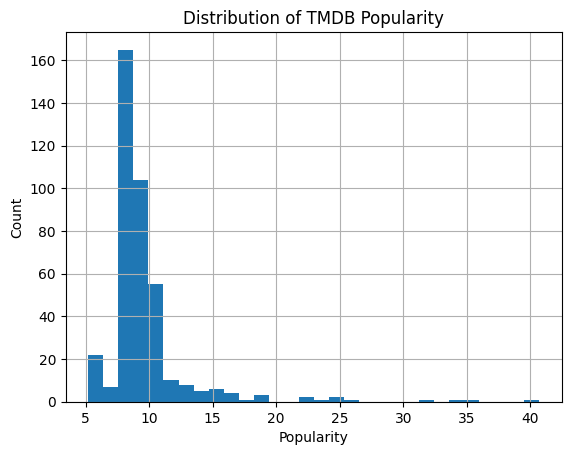

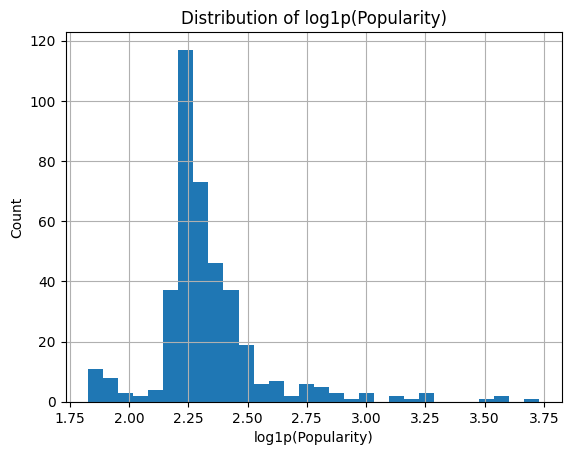

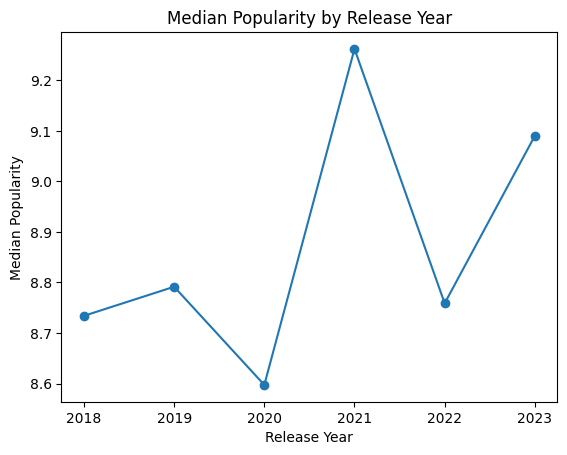

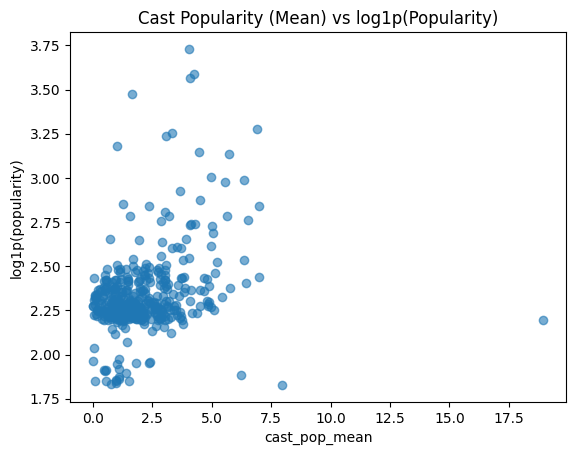

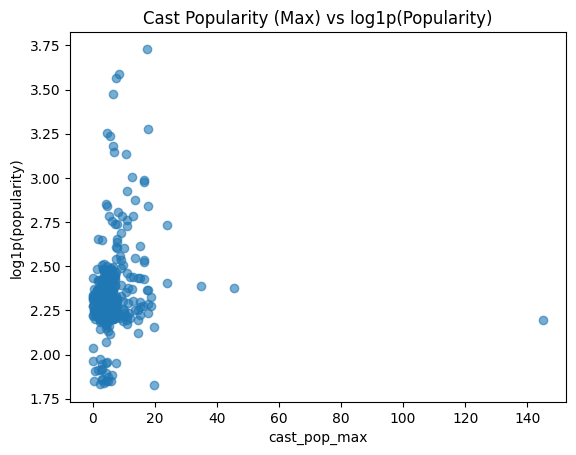

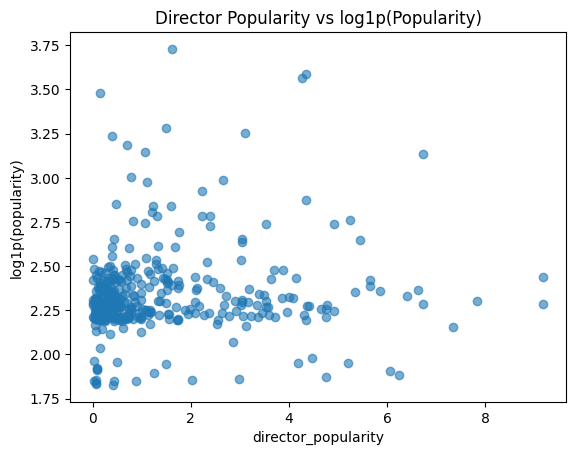

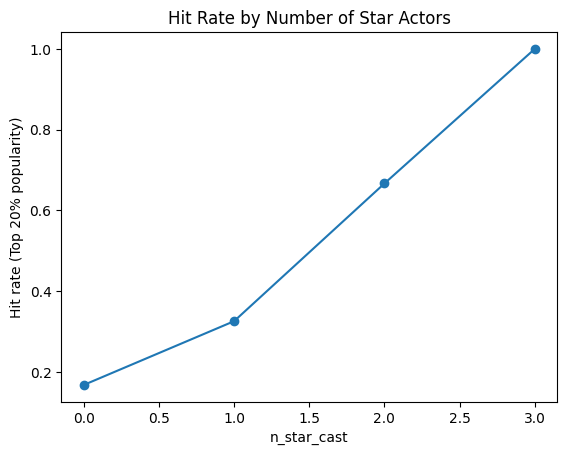

Correlation with popularity (leakage variables):
popularity      1.000000
vote_count      0.452537
vote_average    0.223819
Name: popularity, dtype: float64


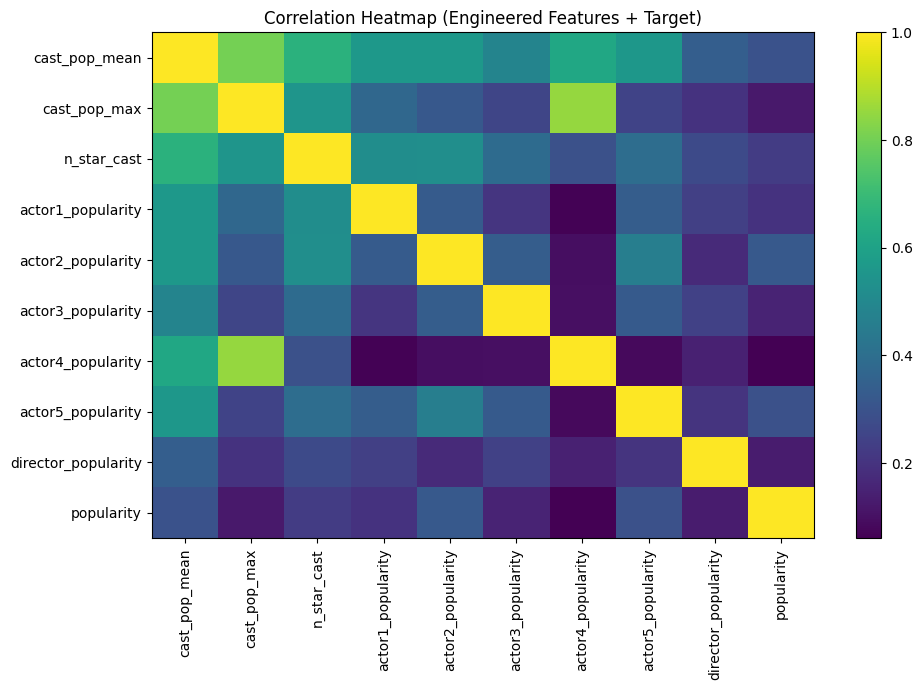

Missing value rate (only > 0):
actor5_gender          0.0650
actor4_gender          0.0400
actor3_gender          0.0275
actor2_gender          0.0100
director_gender        0.0075
director_department    0.0075
actor1_gender          0.0050
dtype: float64


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# ---------- Basic hygiene ----------
df = df.loc[:, ~df.columns.duplicated()].copy()

# Parse release_date if present
if "release_date" in df.columns:
    df["release_date"] = pd.to_datetime(df["release_date"], errors="coerce")
    df["release_year"] = df["release_date"].dt.year
    df["release_month"] = df["release_date"].dt.month

# Quick summary
display(df.head())
print(df.shape)
display(df.describe(include="all").T)

# ---------- 1) Target distribution (popularity) ----------
plt.figure()
df["popularity"].hist(bins=30)
plt.title("Distribution of TMDB Popularity")
plt.xlabel("Popularity")
plt.ylabel("Count")
plt.show()

# Log transform view (often more informative)
plt.figure()
np.log1p(df["popularity"]).hist(bins=30)
plt.title("Distribution of log1p(Popularity)")
plt.xlabel("log1p(Popularity)")
plt.ylabel("Count")
plt.show()

# ---------- 2) Popularity over time ----------
if "release_year" in df.columns:
    tmp = df.dropna(subset=["release_year"]).groupby("release_year")["popularity"].median()
    plt.figure()
    plt.plot(tmp.index, tmp.values, marker="o")
    plt.title("Median Popularity by Release Year")
    plt.xlabel("Release Year")
    plt.ylabel("Median Popularity")
    plt.show()

# ---------- 3) Genre frequency (top 10) ----------
if "genres" in df.columns:
    genre_counts = (
        df["genres"]
        .apply(lambda x: x if isinstance(x, list) else [])
        .explode()
        .value_counts()
        .head(10)
    )

    plt.figure()
    plt.bar(genre_counts.index, genre_counts.values)
    plt.title("Top 10 Genres (Count)")
    plt.xlabel("Genre")
    plt.ylabel("Count")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

# ---------- 4) Do cast/director popularity relate to success? ----------
def scatter(x, y, title, xlabel, ylabel):
    plt.figure()
    plt.scatter(x, y, alpha=0.6)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

if "cast_pop_mean" in df.columns:
    scatter(df["cast_pop_mean"], np.log1p(df["popularity"]),
            "Cast Popularity (Mean) vs log1p(Popularity)",
            "cast_pop_mean", "log1p(popularity)")

if "cast_pop_max" in df.columns:
    scatter(df["cast_pop_max"], np.log1p(df["popularity"]),
            "Cast Popularity (Max) vs log1p(Popularity)",
            "cast_pop_max", "log1p(popularity)")

if "director_popularity" in df.columns:
    scatter(df["director_popularity"], np.log1p(df["popularity"]),
            "Director Popularity vs log1p(Popularity)",
            "director_popularity", "log1p(popularity)")

# ---------- 5) Hit rate by "star" cast count ----------
if "n_star_cast" in df.columns:
    hit = (df["popularity"] >= df["popularity"].quantile(0.8)).astype(int)
    tmp = df.copy()
    tmp["hit"] = hit

    hit_rate = tmp.groupby("n_star_cast")["hit"].mean().sort_index()

    plt.figure()
    plt.plot(hit_rate.index, hit_rate.values, marker="o")
    plt.title("Hit Rate by Number of Star Actors")
    plt.xlabel("n_star_cast")
    plt.ylabel("Hit rate (Top 20% popularity)")
    plt.show()

# ---------- 6) Leakage check (show why votes are excluded) ----------
# These are post-release signals; plot correlation with popularity to justify removal
leak_cols = [c for c in ["vote_average", "vote_count"] if c in df.columns]
if leak_cols:
    corr_leak = df[["popularity"] + leak_cols].corr(numeric_only=True)["popularity"].sort_values(ascending=False)
    print("Correlation with popularity (leakage variables):")
    print(corr_leak)

# ---------- 7) Correlation heatmap for engineered features ----------
feature_candidates = [
    "cast_pop_mean", "cast_pop_max", "n_star_cast",
    "actor1_popularity", "actor2_popularity", "actor3_popularity",
    "actor4_popularity", "actor5_popularity",
    "director_popularity",
    "runtime", "keyword_count"
]
feature_candidates = [c for c in feature_candidates if c in df.columns]

if feature_candidates:
    corr = df[feature_candidates + ["popularity"]].corr(numeric_only=True)

    plt.figure(figsize=(10, 7))
    plt.imshow(corr.values, aspect="auto")
    plt.xticks(range(len(corr.columns)), corr.columns, rotation=90)
    plt.yticks(range(len(corr.index)), corr.index)
    plt.title("Correlation Heatmap (Engineered Features + Target)")
    plt.colorbar()
    plt.tight_layout()
    plt.show()

# ---------- 8) Missing values ----------
missing = df.isna().mean().sort_values(ascending=False)
missing = missing[missing > 0]
print("Missing value rate (only > 0):")
print(missing.head(20))
